# Sobol

In [ ]:
# load library

import pandas as pd
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
import seaborn as sns
import time
import statistics

from ema_workbench import (Model, RealParameter, ScalarOutcome, MultiprocessingEvaluator, 
                           ema_logging, Constant, Scenario, Policy)
from ema_workbench import load_results
from ema_workbench.analysis import prim, dimensional_stacking, cart
from ema_workbench.util import ema_logging
from ema_workbench import save_results

from SALib.analyze import sobol
from ema_workbench.em_framework.evaluators import Samplers
from ema_workbench.em_framework.salib_samplers import get_SALib_problem

ema_logging.log_to_stderr(ema_logging.INFO)

from ema_workbench.em_framework.evaluators import BaseEvaluator
from dike_model_function import DikeNetwork  # @UnresolvedImport
from problem_formulation import get_model_for_problem_formulation

In [12]:


# problem formulation
dike_model, planning_steps = get_model_for_problem_formulation(2)

policies = [Policy("base case without any policies", **{i.name: 0 for i in dike_model.levers})]
problem = get_SALib_problem(dike_model.uncertainties)

start = time.time()

with MultiprocessingEvaluator(dike_model) as evaluator:
    sa_results = evaluator.perform_experiments(scenarios=5000, policies = policies, uncertainty_sampling=Samplers.SOBOL)

end = time.time()

print('Total run time:{} min'.format((end - start)/60))

# Save the results
save_results(sa_results, './results/sobol_results.tar.gz')

[MainProcess/INFO] pool started with 8 workers
/Users/nikhil/anaconda3/lib/python3.11/site-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)
[MainProcess/INFO] performing 200000 scenarios * 1 policies * 1 model(s) = 200000 experiments


  0%|                                               | 0/200000 [00:00<?, ?it/s]

  0%|                                   | 1/200000 [00:05<300:42:50,  5.41s/it]

  0%|                                    | 4/200000 [00:05<59:07:47,  1.06s/it]

  0%|                                    | 9/200000 [00:05<21:58:29,  2.53it/s]

  0%|                                   | 11/200000 [00:05<17:02:42,  3.26it/s]

  0%|                                    | 17/200000 [00:06<9:04:10,  6.12it/s]

  0%|                                    | 22/200000 [00:06<6:22:12,  8.72it/s]

  0%|                                    | 25/200000 [00:06<5:23:51, 10.29it/s]

  0%

Total run time:383.3298923651377 min


[MainProcess/INFO] results saved successfully to /Users/nikhil/Documents/MSc Vakken/Q3/J1Q3 Advanced Simulation/EPA141A-labs/final assignment/EPA141A-labs/final assignment/results/sobol_results.tar.gz


In [13]:
experiments, outcomes = sa_results
problem = get_SALib_problem(dike_model.uncertainties)

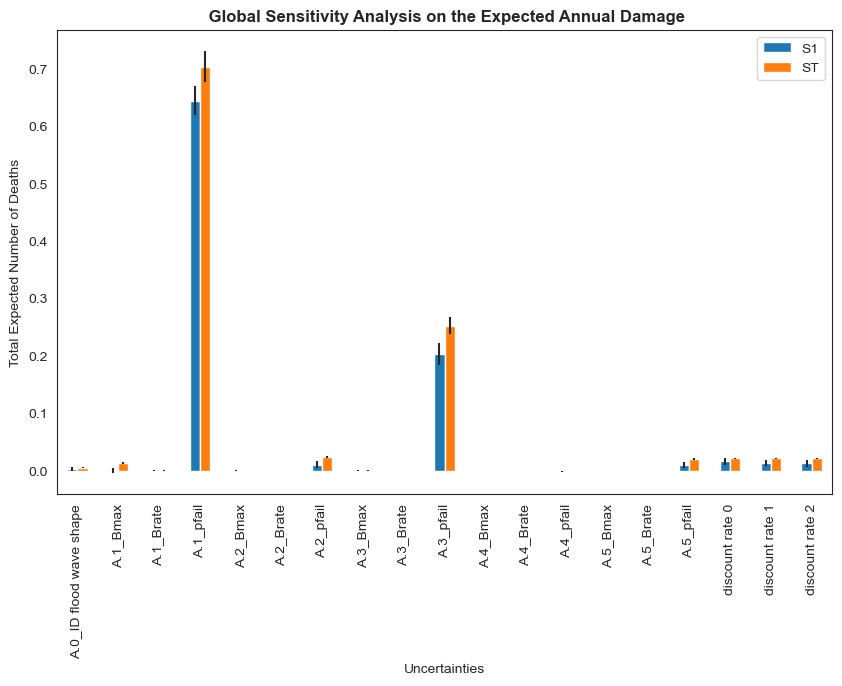

/Users/nikhil/anaconda3/lib/python3.11/site-packages/SALib/analyze/sobol.py:145: RuntimeWarning: invalid value encountered in divide
  Y = (Y - Y.mean()) / Y.std()
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nanmax(masked_verts[..., 1])


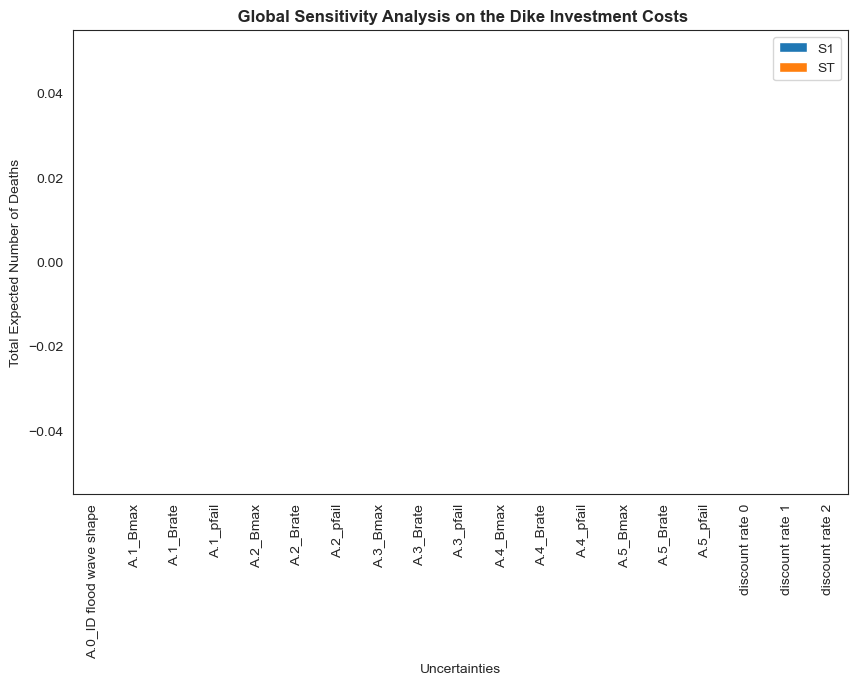

/Users/nikhil/anaconda3/lib/python3.11/site-packages/SALib/analyze/sobol.py:145: RuntimeWarning: invalid value encountered in divide
  Y = (Y - Y.mean()) / Y.std()
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nanmax(masked_verts[..., 1])


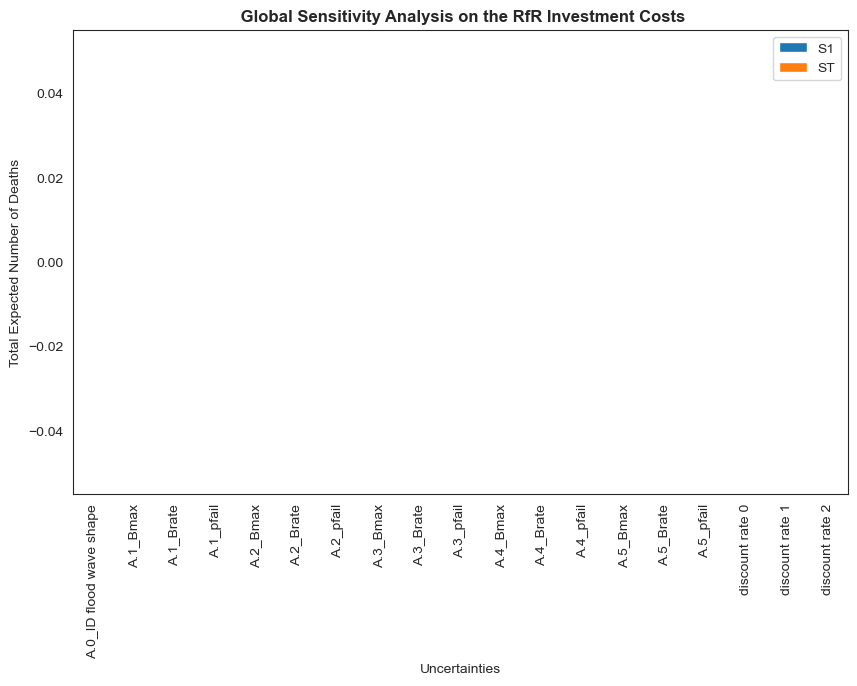

/Users/nikhil/anaconda3/lib/python3.11/site-packages/SALib/analyze/sobol.py:145: RuntimeWarning: invalid value encountered in divide
  Y = (Y - Y.mean()) / Y.std()
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nanmax(masked_verts[..., 1])


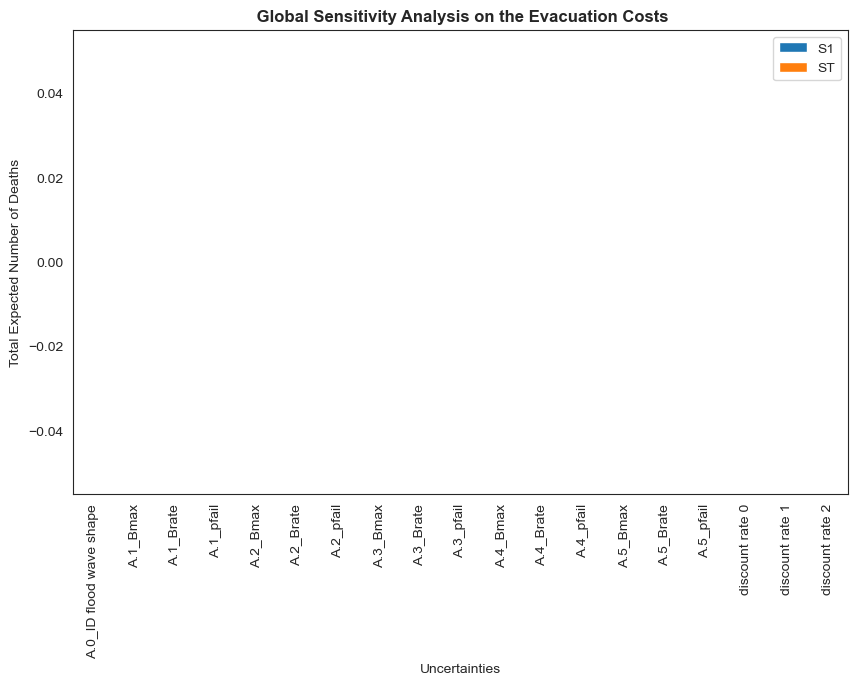

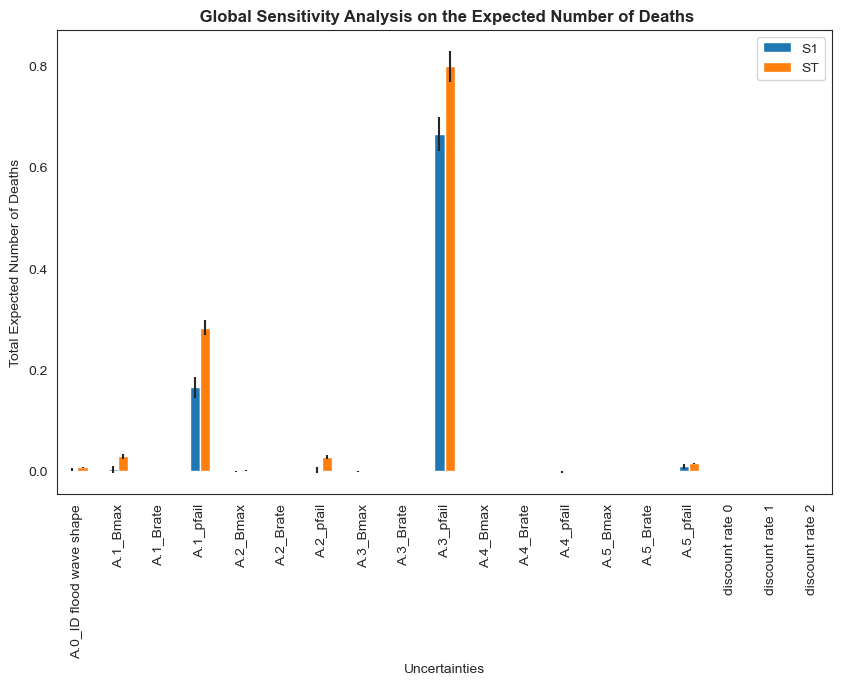

In [14]:
for key in outcomes.keys():
    Si = sobol.analyze(problem, outcomes[key], calc_second_order=True, print_to_console=False)
    scores_filtered = {k: Si[k] for k in ["ST", "ST_conf", "S1", "S1_conf"]}
    Si_df = pd.DataFrame(scores_filtered, index=problem["names"])
    
    sns.set_style("white")
    fig, ax = plt.subplots(1)
    
    indices = Si_df[["S1", "ST"]]
    err = Si_df[["S1_conf", "ST_conf"]]
    
    indices.plot.bar(yerr=err.values.T, ax=ax)
    fig.set_size_inches(10, 8)
    fig.subplots_adjust(bottom=0.3)
    
    #Graph setup
    plt.title(f' Global Sensitivity Analysis on the {key}',fontweight='bold')
    plt.xlabel('Uncertainties')
    plt.ylabel('Total Expected Number of Deaths')
    plt.savefig(f'./images/Sensitivity_sobol_{key}.png')
    plt.show()

Interpretation: A1_pfail and A3_pfail are the most dominant parameters to which the model is sensitive. The relatively small differences between the first-order effects and total-order effects suggest that most of the sensitivity is due to direct effects rather than due to interaction effects.\

A1_pfail = probability that the dike from dikering 1 will withstand the hydraulic load.\
A3_pfail = probability that the dike from dikering 3 will withstand the hydraulic load.

S2 is not readable :)

In [15]:
# problem formulation
dike_model, planning_steps = get_model_for_problem_formulation(3)

policies = [Policy("base case without any policies", **{i.name: 0 for i in dike_model.levers})]
problem = get_SALib_problem(dike_model.uncertainties)

start = time.time()

with MultiprocessingEvaluator(dike_model) as evaluator:
    sa_results_pf3 = evaluator.perform_experiments(scenarios=5000, policies = policies, uncertainty_sampling=Samplers.SOBOL)

end = time.time()

print('Total run time:{} min'.format((end - start)/60))

# Save the results
save_results(sa_results, './results/sobol_results_pf3.tar.gz')

[MainProcess/INFO] pool started with 8 workers
/Users/nikhil/anaconda3/lib/python3.11/site-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)
[MainProcess/INFO] performing 200000 scenarios * 1 policies * 1 model(s) = 200000 experiments


  0%|                                               | 0/200000 [00:00<?, ?it/s]

  0%|                                   | 1/200000 [00:02<152:22:36,  2.74s/it]

  0%|                                    | 9/200000 [00:02<13:27:54,  4.13it/s]

  0%|                                    | 17/200000 [00:03<6:42:11,  8.29it/s]

  0%|                                    | 24/200000 [00:03<4:22:53, 12.68it/s]

  0%|                                    | 28/200000 [00:03<4:01:04, 13.82it/s]

  0%|                                    | 37/200000 [00:03<2:30:58, 22.07it/s]

  0%|                                    | 42/200000 [00:03<2:23:42, 23.19it/s]

  0%

Total run time:393.6292967001597 min


[MainProcess/INFO] results saved successfully to /Users/nikhil/Documents/MSc Vakken/Q3/J1Q3 Advanced Simulation/EPA141A-labs/final assignment/EPA141A-labs/final assignment/results/sobol_results_pf3.tar.gz


In [16]:
experiments, outcomes = sa_results_pf3
problem = get_SALib_problem(dike_model.uncertainties)

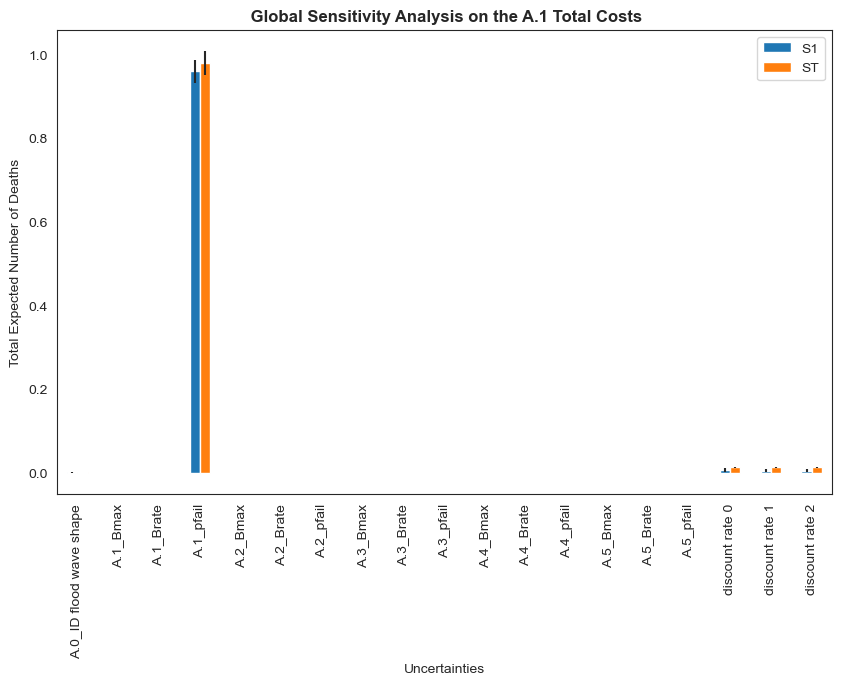

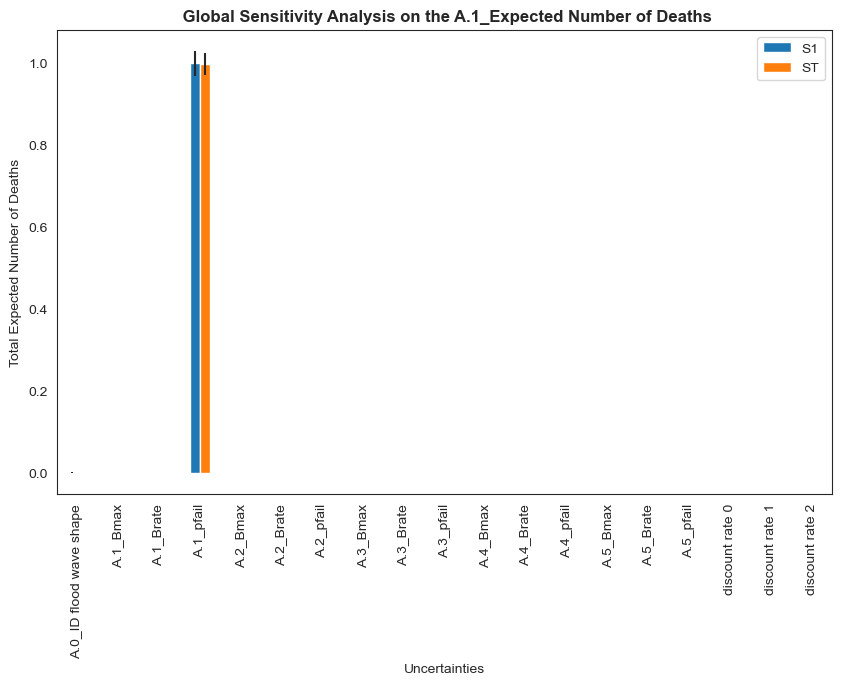

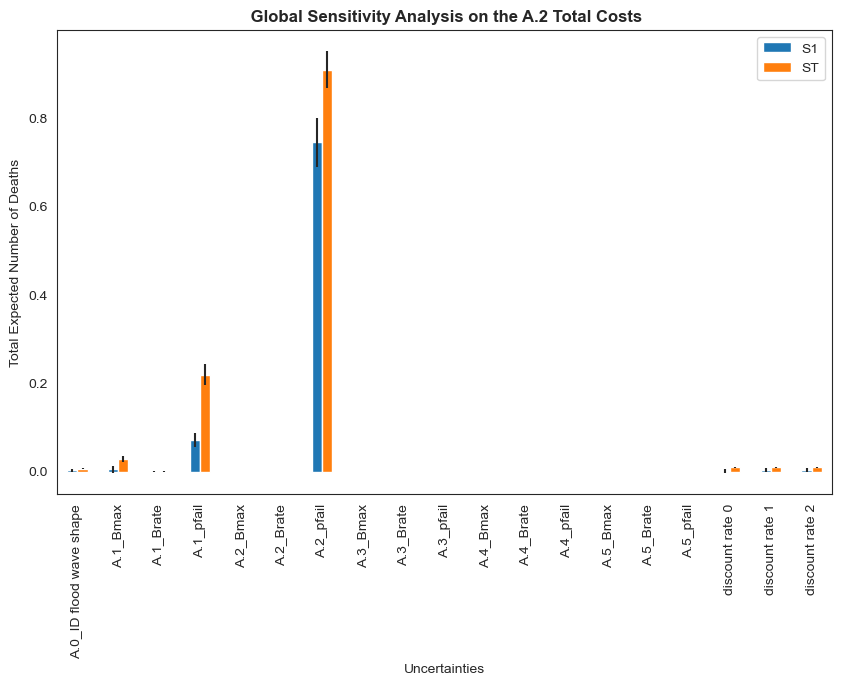

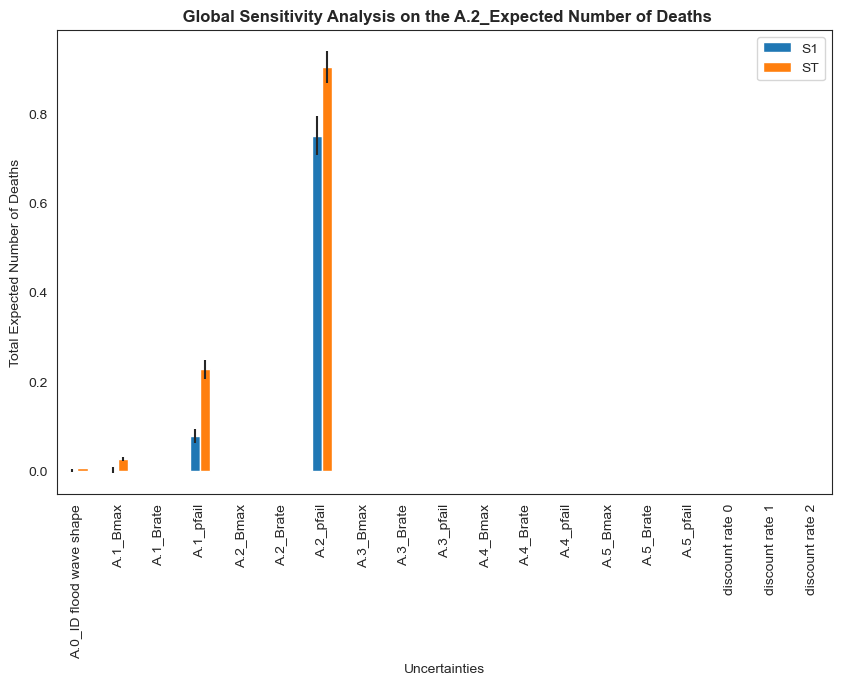

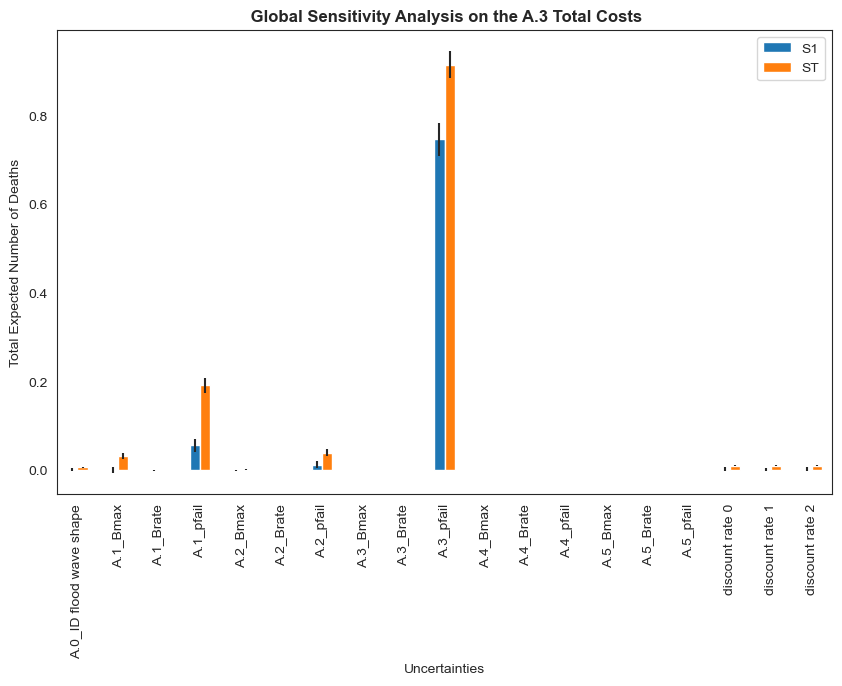

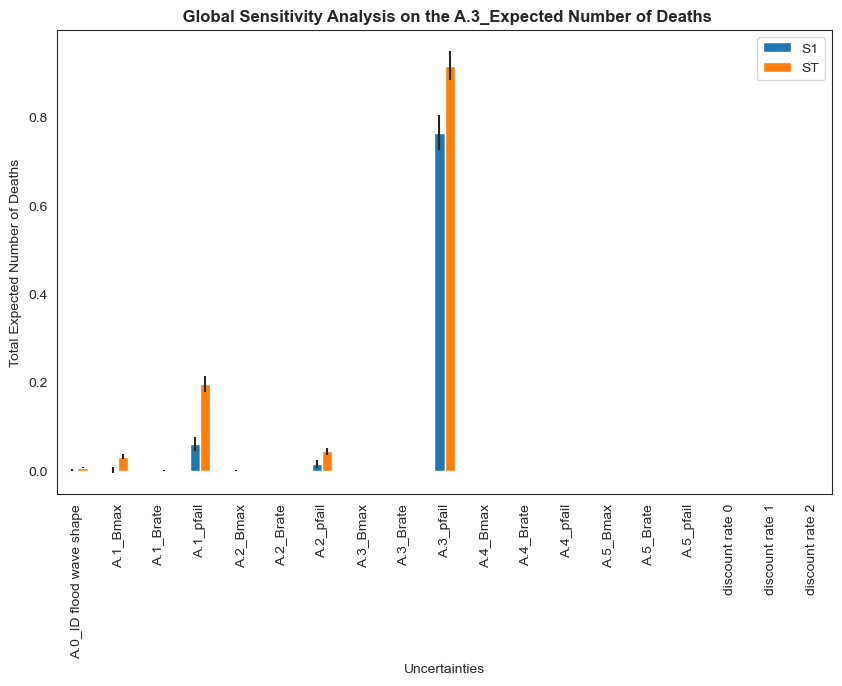

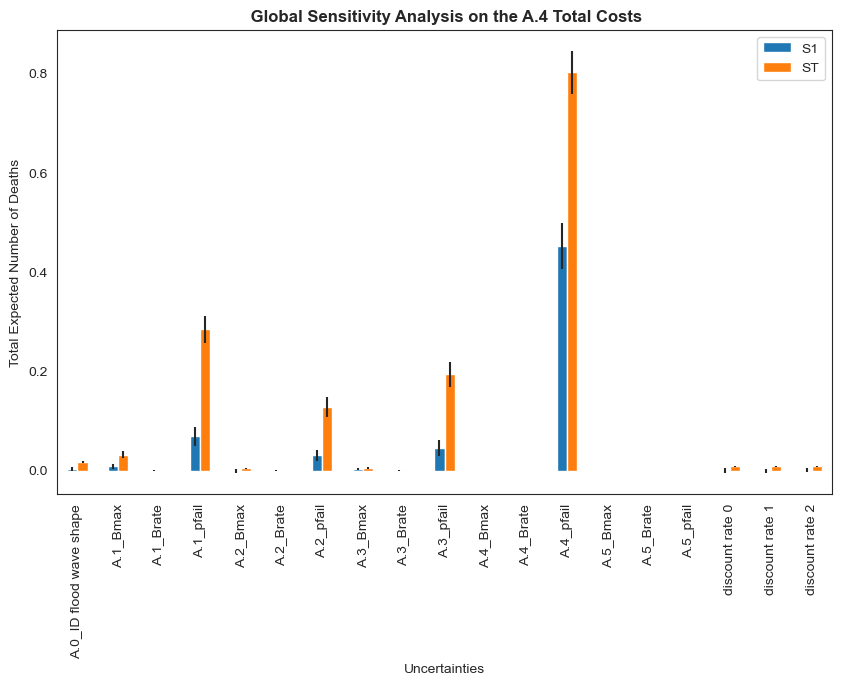

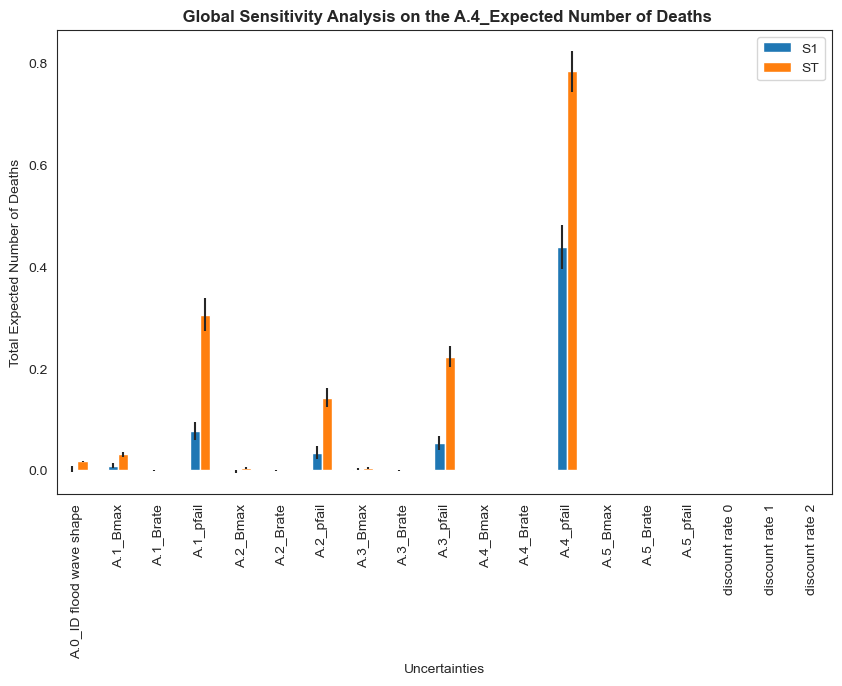

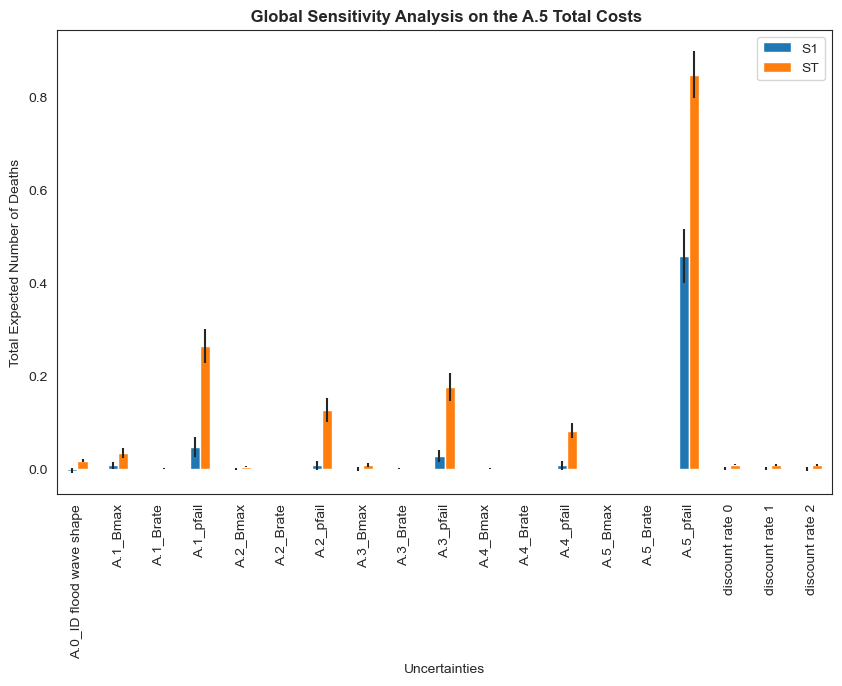

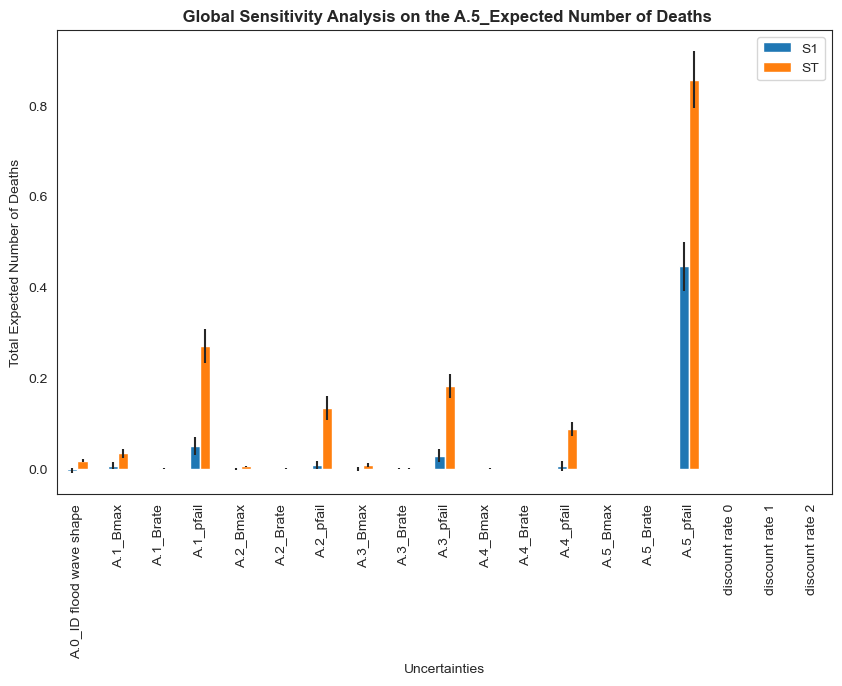

/Users/nikhil/anaconda3/lib/python3.11/site-packages/SALib/analyze/sobol.py:145: RuntimeWarning: invalid value encountered in divide
  Y = (Y - Y.mean()) / Y.std()
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nanmax(masked_verts[..., 1])


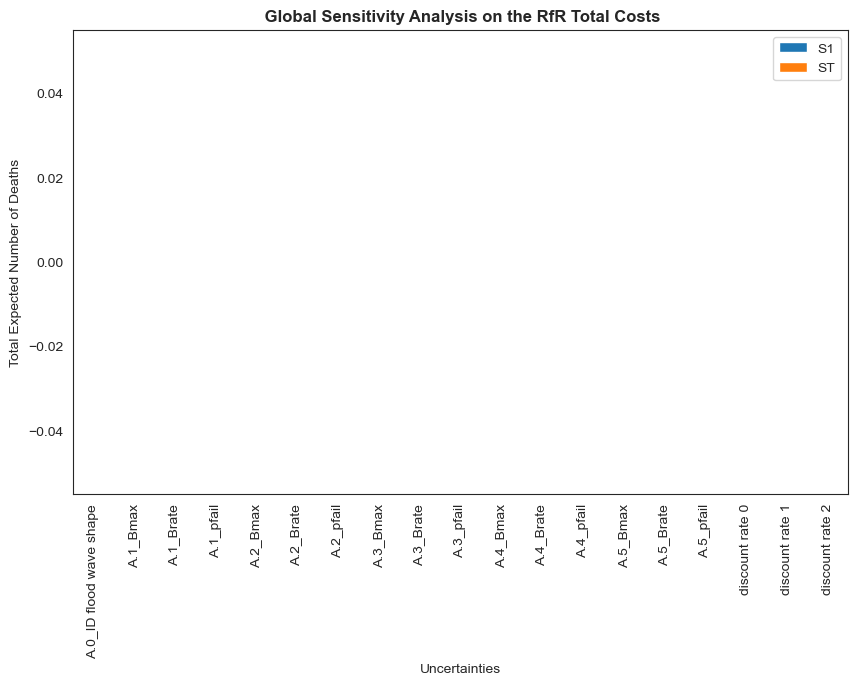

/Users/nikhil/anaconda3/lib/python3.11/site-packages/SALib/analyze/sobol.py:145: RuntimeWarning: invalid value encountered in divide
  Y = (Y - Y.mean()) / Y.std()
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1185: RuntimeWarning: All-NaN axis encountered
  miny = np.nanmin(masked_verts[..., 1])
/Users/nikhil/anaconda3/lib/python3.11/site-packages/matplotlib/axes/_axes.py:1186: RuntimeWarning: All-NaN axis encountered
  maxy = np.nanmax(masked_verts[..., 1])


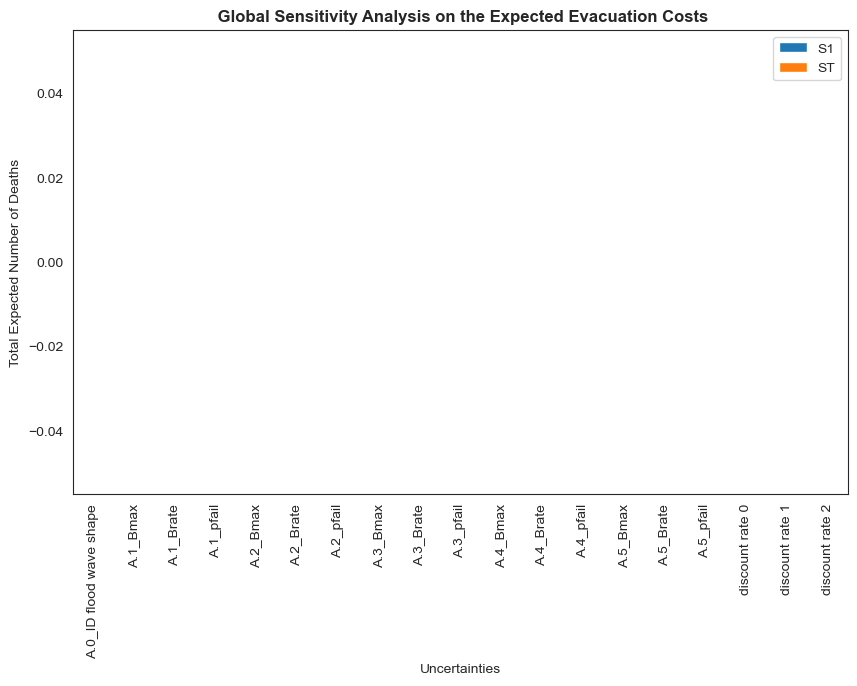

In [17]:
for key in outcomes.keys():
    Si = sobol.analyze(problem, outcomes[key], calc_second_order=True, print_to_console=False)
    scores_filtered = {k: Si[k] for k in ["ST", "ST_conf", "S1", "S1_conf"]}
    Si_df = pd.DataFrame(scores_filtered, index=problem["names"])
    
    sns.set_style("white")
    fig, ax = plt.subplots(1)
    
    indices = Si_df[["S1", "ST"]]
    err = Si_df[["S1_conf", "ST_conf"]]
    
    indices.plot.bar(yerr=err.values.T, ax=ax)
    fig.set_size_inches(10, 8)
    fig.subplots_adjust(bottom=0.3)
    
    #Graph setup
    plt.title(f' Global Sensitivity Analysis on the {key}',fontweight='bold')
    plt.xlabel('Uncertainties')
    plt.ylabel('Total Expected Number of Deaths')
    plt.savefig(f'./images/Sensitivity_sobol_{key}.png')
    plt.show()

# Open Exploration: Uncertainty Analysis (Feature Scoring)

This analysis investigates how uncertainties in the Ijssel River simulation model can affect its outcomes. We use a technique called feature scoring to measure how closely each uncertainty is linked to specific results of the model.

We've chosen specific outputs from the model that are important to the province of Gelderland for this analysis. You can find more
details on these outputs in the report. This version uses simpler terms and breaks down the technical concepts into easier-to-understand parts. For a more detailed elaboration of the model results, please refer to the report. 

| Outcome Name | Outcome Name on the Code |
| --- | --- |
|  |  |
|  |  |
|  |  |
|  |  |
|  |  |

To ensure a comprehensive investigation, we have also included the following additional outcomes:

| Outcome Name | Outcome Name on the Code |
| --- | --- |
| |  |
|  |  |
|  |  |
|  |  |
|  |  |
|  |  |
| |  |
|  |  |

In [38]:
# # Load results from base case for N scenarios
# results = load_results('./results/sobol_results.tar.gz') #tar.gz file
experiments, outcomes = sa_results

# # Policy levers are equal to zero in the base case scenario. For this reason, we can drop the columns that contain the policy levers.
# model, steps = get_model_for_problem_formulation(2) #insert problem formulation
# policy_levers = [lever.name for lever in model.levers]
# experiments = experiments.drop(columns=policy_levers)

# experiments

[MainProcess/INFO] results loaded successfully from /Users/nikhil/Documents/MSc Vakken/Q3/J1Q3 Advanced Simulation/EPA141A-labs/final assignment/EPA141A-labs/final assignment/results/sobol_results.tar.gz


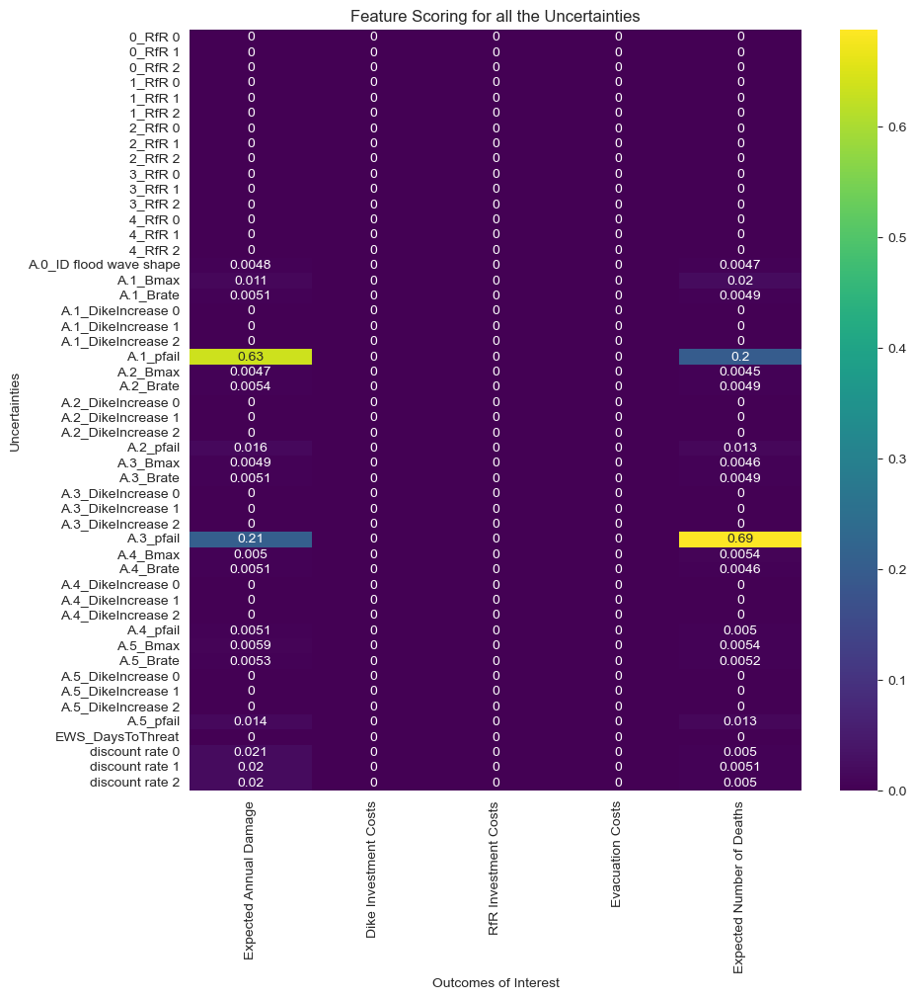

In [41]:
from ema_workbench.analysis import feature_scoring
x = experiments
y = outcomes

fs = feature_scoring.get_feature_scores_all(x, y)
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(fs, cmap="viridis", annot=True)

#Graph setup
plt.title('Feature Scoring for all the Uncertainties')
plt.ylabel('Uncertainties')
plt.xlabel('Outcomes of Interest')
plt.savefig('./images/Sensitivity_Feature_Scoring.png')
plt.show()

In [42]:
# # Load results from base case for N scenarios
# results = load_results('./results/sobol_results_pf3.tar.gz') #tar.gz file
experiments, outcomes = sa_results_pf3
# 
# # Policy levers are equal to zero in the base case scenario. For this reason, we can drop the columns that contain the policy levers.
# model, steps = get_model_for_problem_formulation(3) #insert problem formulation
# policy_levers = [lever.name for lever in model.levers]
# experiments = experiments.drop(columns=policy_levers)

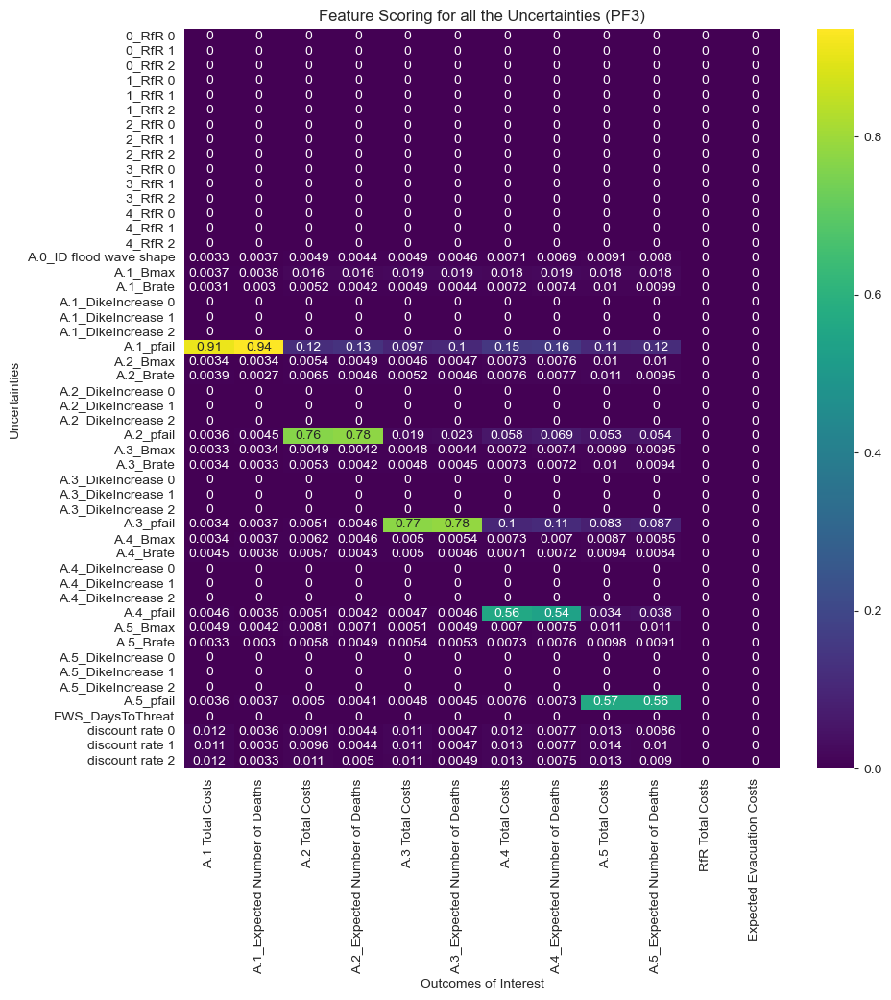

In [43]:
from ema_workbench.analysis import feature_scoring

experiments, outcomes = sa_results_pf3
x = experiments
y = outcomes

fs = feature_scoring.get_feature_scores_all(x, y)
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(fs, cmap="viridis", annot=True)

#Graph setup
plt.title('Feature Scoring for all the Uncertainties (PF3)')
plt.ylabel('Uncertainties')
plt.xlabel('Outcomes of Interest')
plt.savefig('./images/Sensitivity_Feature_Scoring_pf3.png')
plt.show()